In [2]:
!pip install -q top2vec[sentence_encoders]

import json
from top2vec import Top2Vec
import re
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick


def load_data(filename):
    with open(filename,"r") as f:
        d = json.load(f)
    return d

def num_words(text):
    return len(text.split(' '))

def parse_submissions_exploded(data, latest_time=None):
    doc_list = []
    for submission in data:
        if latest_time is None or submission.get('created_utc', 0) <= latest_time:
            thread_link = submission.get('permalink', '')
            author = submission.get('author', '')
            if num_words(submission.get('title', '')) >= 5:
                doc = {'text':submission.get('title', ''),\
                       'created_utc':submission.get('created_utc', 0),\
                       'thread_link':thread_link,\
                       'author':author}
                doc_list.append(doc)
            reply_list = submission.get('comment_list', [])
            for reply in reply_list:
                if num_words(reply.get('body', '')) >= 5:
                    doc = {'text':reply.get('body', ''),\
                           'created_utc':reply.get('created_utc', 0),\
                           'thread_link':thread_link,\
                           'author':reply.get('author','')}
                    doc_list.append(doc)
    return doc_list

def threads_to_exploded_doc_list(filename, latest_time=None):
    data = load_data(filename)
    return parse_submissions_exploded(data, latest_time)

def print_top_topic_docs(model, topic_num):
    documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_num, num_docs=5)
    for doc, score, doc_id in zip(documents, document_scores, document_ids):
        print(f"Document: {doc_id}, Score: {score}")
        print("-----------")
        print(doc)
        print("-----------")
        print()

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tfx-bsl 1.9.0 requires pyarrow<6,>=1, but you have pyarrow 8.0.0 which is incompatible.
tensorflow-transform 1.9.0 requires pyarrow<6,>=1, but you have pyarrow 8.0.0 which is incompatible.
tensorflow-transform 1.9.0 requires tensorflow!=2.0.*,!=2.1.*,!=2.2.*,!=2.3.*,!=2.4.*,!=2.5.*,!=2.6.*,!=2.7.*,!=2.8.*,<2.10,>=1.15.5, but you have tensorflow 2.11.0 which is incompatible.
tensorflow-io 0.21.0 requires tensorflow<2.7.0,>=2.6.0, but you have tensorflow 2.11.0 which is incompatible.
tensorflow-io 0.21.0 requires tensorflow-io-gcs-filesystem==0.21.0, but you have tensorflow-io-gcs-filesystem 0.29.0 which is incompatible.


2022-12-21 19:59:26.148241: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-21 19:59:26.330072: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/cuda/lib:/usr/local/lib/x86_64-linux-gnu:/usr/local/nvidia/lib:/usr/local/nvidia/lib64:
2022-12-21 19:59:26.330126: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-12-21 19:59:27.638237: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] 

In [3]:
filename = '/kaggle/input/reddit-worldcup/reddit_worldcup_500_2022-12-18 19_19_01.json'
doc_dict_list = threads_to_exploded_doc_list(filename)

doc_list = [re.sub(r'http\S+', '', doc['text']) for doc in doc_dict_list]
doc_list = [re.sub(r'www\S+', '', doc['text']) for doc in doc_dict_list]

In [15]:
hdbscan_args = {'min_samples': 40,
                'min_cluster_size': 500,
                'metric': 'euclidean',
                'cluster_selection_method': 'leaf'}

umap_args = {'n_neighbors': 25,
             'n_components': 15,
             'metric': 'cosine'}

top2vec_use = Top2Vec(documents=doc_list, speed="deep-learn", embedding_model='universal-sentence-encoder', hdbscan_args=hdbscan_args, umap_args=umap_args)

2022-12-19 15:56:35,381 - top2vec - INFO - Pre-processing documents for training
/opt/conda/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
2022-12-19 15:56:50,176 - top2vec - INFO - Downloading universal-sentence-encoder model
2022-12-19 15:56:56,232 - top2vec - INFO - Creating joint document/word embedding
2022-12-19 15:57:50,896 - top2vec - INFO - Creating lower dimension embedding of documents
2022-12-19 16:01:31,459 - top2vec - INFO - Finding dense areas of documents
2022-12-19 16:01:54,864 - top2vec - INFO - Finding topics


In [13]:
top2vec_use.get_num_topics()

44

In [4]:
#top2vec_use.save('top2vec_use_44_clusters.model')
top2vec_use = Top2Vec.load('/kaggle/input/reddit-worldcup/top2vec_use_44_clusters.model')

In [5]:
def model_to_df(model):
    #doc_topic_num = model.doc_top
    #docs = model.documents
    topic_words, word_scores, topic_nums = top2vec_use.get_topics()
    topic_sizes, topic_nums = model.get_topic_sizes()
    topic_docs = [{'topic_num':topic_num,
                   'topic_size':topic_sizes[topic_num],
                   'topic_words':topic_words[topic_num],
                   'top_docs':model.search_documents_by_topic(topic_num=topic_num, num_docs=5)[0]}\
                  for topic_num in range(top2vec_use.get_num_topics())]
    top_docs_df = pd.DataFrame(topic_docs)
    return top_docs_df


df = model_to_df(top2vec_use)
df.to_csv('topic_model_44.csv')

In [6]:
doc_df = pd.DataFrame(doc_dict_list)
doc_df['topic_num'] = top2vec_use.doc_top
doc_df.drop('author', axis=1).head()

,text,created_utc,thread_link,topic_num
0,####*Hello! Thanks for your submission to /r/w...,1.670016e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,32
1,"Why does this thread have 22,000 upvotes with ...",1.670178e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,0
2,"“We’re going home”\n\n-Korea, 10 min into roun...",1.670268e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,22
3,"Against all odds…again lol, Morocco for the fi...",1.670709e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,23
4,"Honestly a 50/50 match, gonna be close and ver...",1.671058e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,9


In [7]:
num_docs = len(doc_df)
num_commenters = len(doc_df.groupby('author').size())
num_topics = len(doc_df.groupby('topic_num').size())
largest_topic = doc_df.groupby('topic_num').size().sort_values(ascending=False)[0]
largest_thread = doc_df.groupby('thread_link').size().sort_values(ascending=False)[0]

print('Among the top 500 threads on r/world cup, the most active thread had {largest_thread} replies. In total, {num_commenters} commenters posted {num_docs} replies that were clusterd into {num_topics} topics. {largest_topic} replies were classified into the largest topic. The most common topic is users arguing and top 5 ventral documents from the most popular topic are:\n'.format(\
            num_docs=num_docs,\
            largest_thread=largest_thread,\
            num_topics=num_topics,\
            largest_topic=largest_topic,\
            num_commenters=num_commenters))


print_top_topic_docs(top2vec_use, 0)

Among the top 500 threads on r/world cup, the most active thread had 5987 replies. In total, 34936 commenters posted 135520 replies that were clusterd into 44 topics. 10260 replies were classified into the largest topic. The most common topic is users arguing and top 5 ventral documents from the most popular topic are:

Document: 83903, Score: 0.7453784346580505
-----------
This whole comment is dumb.  Sorry.
-----------

Document: 14744, Score: 0.7366885542869568
-----------
Haha, that's not an explanation, you imbecile.
-----------

Document: 82195, Score: 0.7326595783233643
-----------
Damn, you are really stupid
-----------

Document: 99929, Score: 0.7260280847549438
-----------
I get it now - I misread your comment, my bad. I agree with you now lol
-----------

Document: 92746, Score: 0.7204647064208984
-----------
Omg you clearly have no idea what you are talking about, do you?
-----------



In [9]:
'''
Topics were manually labeled here: https://docs.google.com/spreadsheets/d/1T1iINMge1jrGLmm0HzeYayeGoGuUpkdwJqqf_5_0DgE/
'''
topic_labels_dict_list = [{'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing', 'topic_num':0}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Messi & the greats', 'topic_num':1}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Not playing well', 'topic_num':2}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Good Team vs Good Tournement', 'topic_num':3}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'England & France', 'topic_num':4}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing', 'topic_num':5}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'General World Cup', 'topic_num':6}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Qatar Corruption', 'topic_num':7}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Football vs Soccer', 'topic_num':8}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'In-Match Game Discussion', 'topic_num':9}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Soccer in USA', 'topic_num':10}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'General Soccer Discussion', 'topic_num':11}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Winning & Losing', 'topic_num':12}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Scoring Goals', 'topic_num':13}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Soccer in USA', 'topic_num':14}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Penalty/Offisides', 'topic_num':15}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'LGBTQ', 'topic_num':16}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Argentina', 'topic_num':17}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing (racism)', 'topic_num':18}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'South American Teams', 'topic_num':19}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Penalty/Fouls', 'topic_num':20}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'England & France', 'topic_num':21}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Japan/Germany/Spain', 'topic_num':22}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Morocco', 'topic_num':23}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Finals Predictions', 'topic_num':24}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Finals Predictions', 'topic_num':25}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Goal Celebrations', 'topic_num':26}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Cards', 'topic_num':27}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Netherlands/Dutch', 'topic_num':28}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Bad Reffing', 'topic_num':29}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Religon', 'topic_num':30}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Migrant Deaths', 'topic_num':31}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing', 'topic_num':32}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Penalties', 'topic_num':33}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Iran Govt', 'topic_num':34}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'Reffing (Japan Ball)', 'topic_num':35}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Alcohol Ban', 'topic_num':36}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'France', 'topic_num':37}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing (Portuguese)', 'topic_num':38}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Expensive Concessions', 'topic_num':39}, {'inferred_topic':'General Soccer Discussion', 'granular_inferred_topic':'Saudi Arabia (beat Argentina)', 'topic_num':40}, {'inferred_topic':'Qatar, FIFA, Religon, & Politics', 'granular_inferred_topic':'Australia in Asia Oceanic', 'topic_num':41}, {'inferred_topic':'Rules & Reffing Decisions', 'granular_inferred_topic':'VAR', 'topic_num':42}, {'inferred_topic':'Internet Arguing', 'granular_inferred_topic':'Internet Arguing (Portuguese)', 'topic_num':43}]
topic_labels_df = pd.DataFrame(topic_labels_dict_list)
doc_df_labeled = doc_df.merge(topic_labels_df, how='left', on='topic_num')

doc_df_labeled['ts'] = pd.to_datetime(doc_df_labeled['created_utc'], unit='s')
doc_df_labeled['date'] = doc_df_labeled['ts'].dt.floor('d')

doc_df_labeled.drop('author', axis=1).head()

,text,created_utc,thread_link,topic_num,inferred_topic,granular_inferred_topic,ts,date
0,####*Hello! Thanks for your submission to /r/w...,1.670016e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,32,Internet Arguing,Internet Arguing,2022-12-02 21:15:28,2022-12-02
1,"Why does this thread have 22,000 upvotes with ...",1.670178e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,0,Internet Arguing,Internet Arguing,2022-12-04 18:24:25,2022-12-04
2,"“We’re going home”\n\n-Korea, 10 min into roun...",1.670268e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,22,General Soccer Discussion,Japan/Germany/Spain,2022-12-05 19:20:55,2022-12-05
3,"Against all odds…again lol, Morocco for the fi...",1.670709e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,23,General Soccer Discussion,Morocco,2022-12-10 21:56:44,2022-12-10
4,"Honestly a 50/50 match, gonna be close and ver...",1.671058e+09,/r/worldcup/comments/zaxwe9/rworldcup_knockout...,9,General Soccer Discussion,In-Match Game Discussion,2022-12-14 22:43:17,2022-12-14


In [10]:
doc_df_labeled.groupby('inferred_topic').size().sort_values(ascending=False)

inferred_topic
General Soccer Discussion           76535
Internet Arguing                    26491
Qatar, FIFA, Religon, & Politics    17340
Rules & Reffing Decisions           15154
dtype: int64

In [11]:
hourly_topic_comments = doc_df_labeled.groupby(['date', 'inferred_topic'])\
    .size()\
    .reset_index(name='topic_comments')#\
    #.pivot(index='ts_hour', columns='inferred_topic', values='count')\
    #.reset_index().fillna(0)\
    #.fillna(0)

hourly_comments = doc_df_labeled.groupby(['date'])\
    .size()\
    .reset_index(name='total_comments')#

hourly_topics_long = hourly_topic_comments.merge(hourly_comments, how='left', on='date')
hourly_topics_long['topic_percent'] = 1.0 * hourly_topics_long['topic_comments'] / hourly_topics_long['total_comments']

hourly_topics = hourly_topics_long[['date', 'inferred_topic', 'topic_percent']]\
    .pivot(index='date', columns='inferred_topic', values='topic_percent')\
    .reset_index()\
    .fillna(0)

In [16]:
hourly_topics_long.head(5)

,date,inferred_topic,topic_comments,total_comments,topic_percent
0,2022-11-18,General Soccer Discussion,273,1170,0.233333
1,2022-11-18,Internet Arguing,168,1170,0.143590
2,2022-11-18,"Qatar, FIFA, Religon, & Politics",710,1170,0.606838
3,2022-11-18,Rules & Reffing Decisions,19,1170,0.016239
4,2022-11-19,General Soccer Discussion,745,2275,0.327473


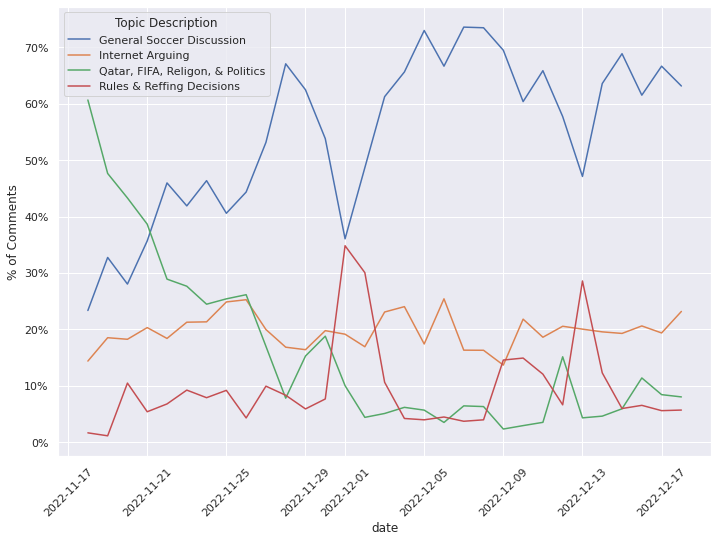

In [13]:
sns.set(rc={'figure.figsize':(11.7,8.27)})

ax = sns.lineplot(x='date',  y='topic_percent', hue='inferred_topic', data=hourly_topics_long)
plt.xticks(rotation=45)
plt.ylabel('% of Comments')
plt.legend(title = "Topic Description")

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

<AxesSubplot:xlabel='date', ylabel='topic_comments'>

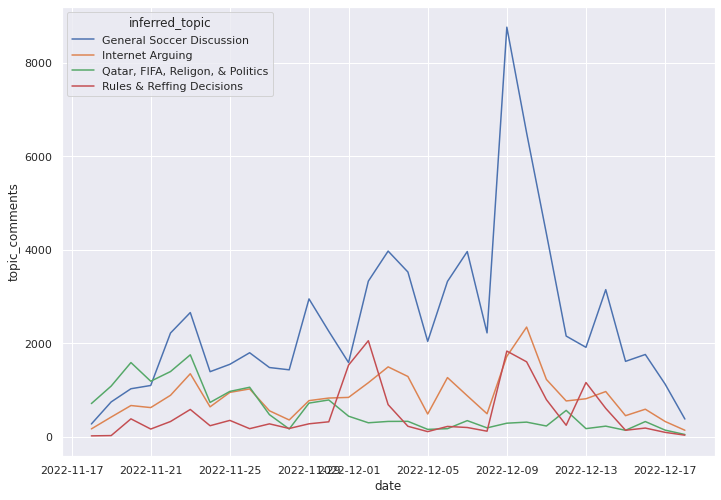

In [14]:
sns.lineplot(x='date',  y='topic_comments', hue='inferred_topic', data=hourly_topics_long)

# **Word Clouds**

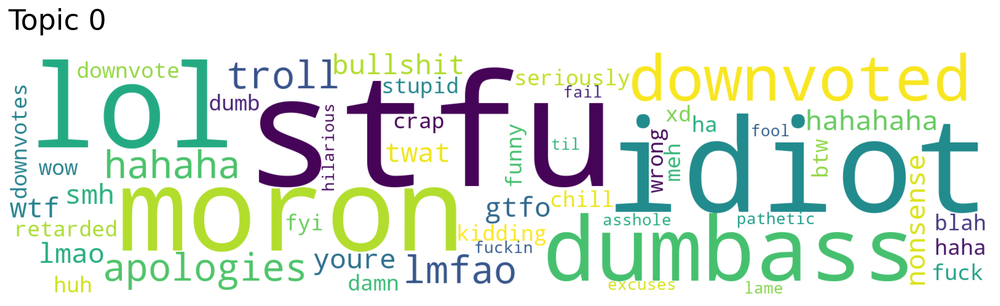

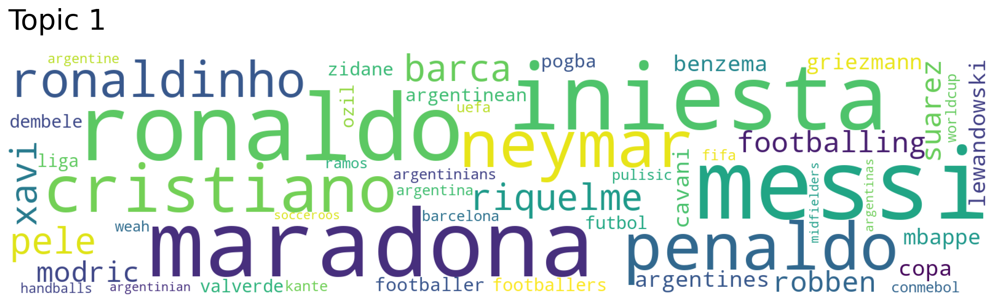

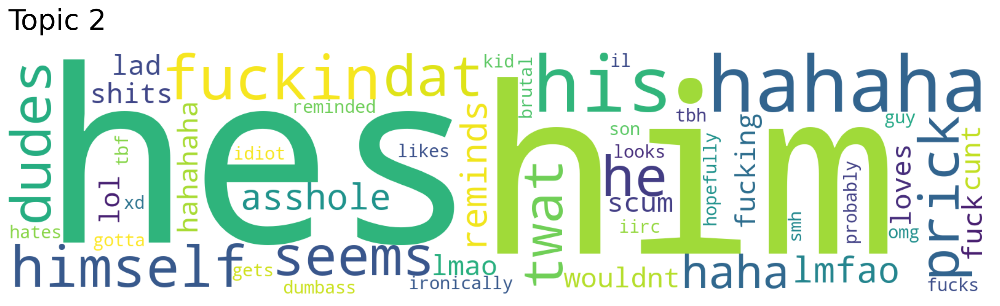

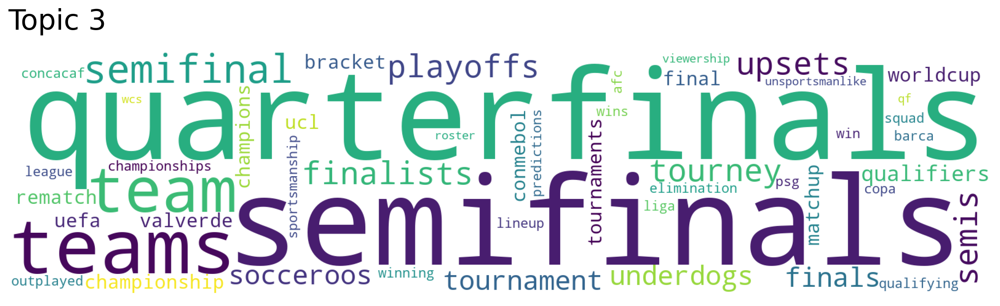

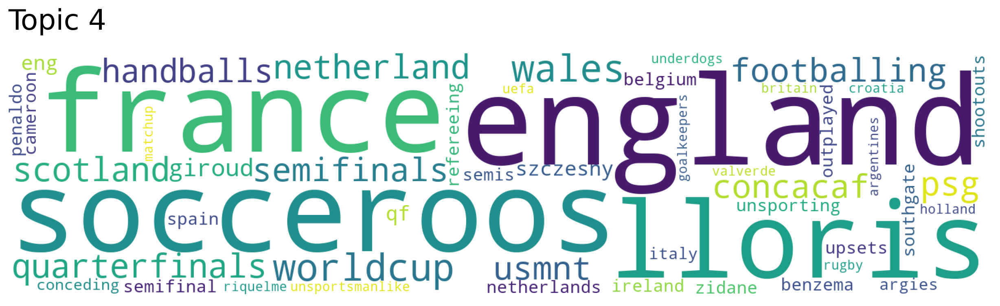

...

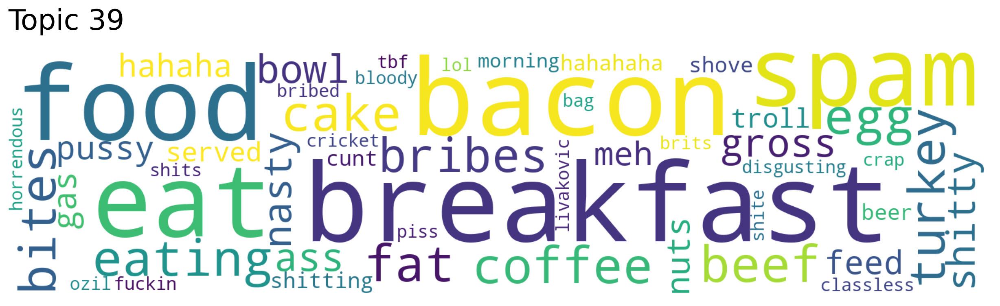

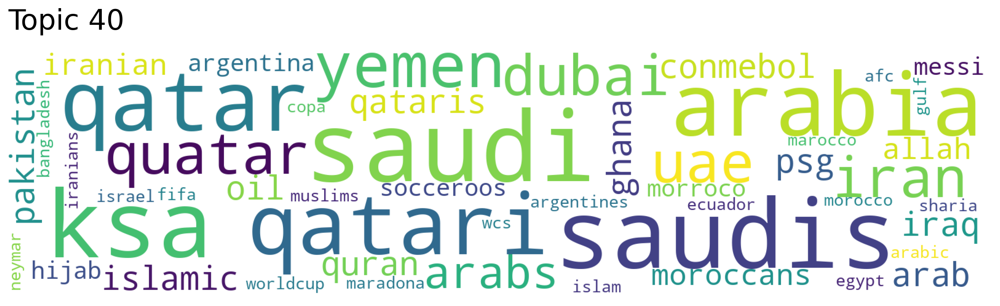

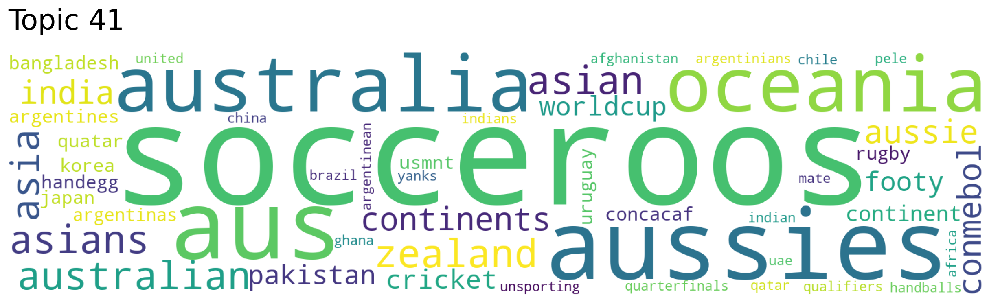

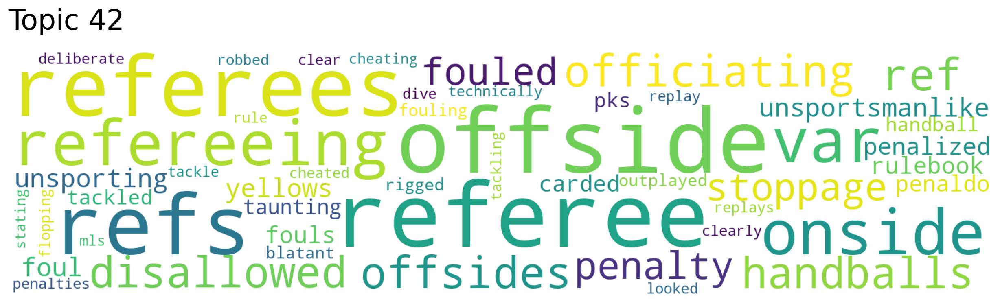

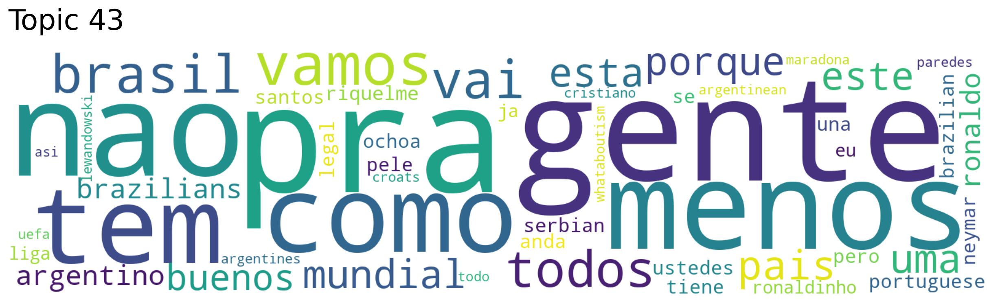

In [12]:
topic_words, word_scores, topic_nums = top2vec_use.get_topics()

for topic in topic_nums:
    top2vec_use.generate_topic_wordcloud(topic, background_color="white")